# Apply Bond to manual PSAP: 

In this script I will collect, clean and organise the raw data files for the new PSAP stationed at Zeppelin. The "New PSAP" as it is known operates using an automatic filter change. Whereby the filter is changed when the tranmission decreases by a certain amount. As the aerosol concentrations are lower in the summer, the samping times/duration the filter is on is greater.

The data is sorted via the separate filters, the filters are then inspected and the "bad filters" are removed. 

Finally, a rolling averge is applied for 3 neigbouring points (set on the middle point). The Bond correction is done with a time step (set at 15 minutes). The absorption coefficent is calculated by loking at the change in the transmission.

Single wavelength PSAP operating at 525 nm:
- Filter area = 8.04e-6
- Filterconstant = 2
- Timeresolution of instrument output to raw data file is 1minute

In [1]:
import sys

sys.path.append(r'C:\Users\DominicHeslinRees\Documents\ACP_2023\scripts\OLD_PSAP_Bond')
import OLD_PSAP_bond_functions as fu_OldPSAP

%load_ext autoreload
%autoreload 2

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import datasets, linear_model

In [2]:
out_path_plots = "C:\\Users\\DominicHeslinRees\\Pictures\\black_carbon\\old_PSAP\\"
savepath = r'C:\Users\DominicHeslinRees\Documents\ACP_2023\Analysis\absorption\Old_PSAP'

In [3]:
print('\n'.join(f'{m.__name__}=={m.__version__}' for m in globals().values() if getattr(m, '__version__', None)))

json==2.0.9
numpy==1.22.4
pandas==1.3.3


In [4]:
RAW_OLD_PSAP = fu_OldPSAP.append_soot_raw("C:\\Users\\DominicHeslinRees\\Documents\\Data\\PSAP\\PSAP_RAW\\RAW_2006-2014\\",
                                         np.arange(2006,2015,1), 
                                         ['Date', 'Time', 'Io', 'I', 'qobs', 'Lnr', 'Qset', 'InTime'],
                                         'sootraw')

year: 2006
length: 251
year: 2007
length: 365
year: 2008
length: 353
year: 2009
length: 363
year: 2010
length: 335
year: 2011
length: 364
year: 2012
length: 356
year: 2013
length: 343
year: 2014
length: 114


In [5]:
RAW_OLD_PSAP

,Io,I,qobs,Lnr,Qset,InTime
2006-04-19 23:00:40,-0.006252,0.000149,-0.004408,3.16087,0.039,1
2006-04-19 23:01:40,-0.006159,0.000188,-0.004400,3.16087,0.039,1
2006-04-19 23:02:40,-0.006345,0.000104,-0.004452,3.16087,0.039,1
2006-04-19 23:03:40,-0.006620,0.000271,-0.004428,3.16087,0.039,1
2006-04-19 23:04:40,-0.006401,0.000541,-0.004482,3.16087,0.039,1
...,...,...,...,...,...,...
0,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
RAW_OLD_PSAP = fu_OldPSAP.remove_meaningless_values(RAW_OLD_PSAP)
fu_OldPSAP.save_df(RAW_OLD_PSAP, name='RAW_OLD_PSAP', path=savepath)

Save to: C:\Users\DominicHeslinRees\Documents\ACP_2023\Analysis\absorption\Old_PSAP


In [7]:
RAW_OLD_PSAP = fu_OldPSAP.add_jumps(RAW_OLD_PSAP)

0.0012337380876141625
0.0007671176529931564


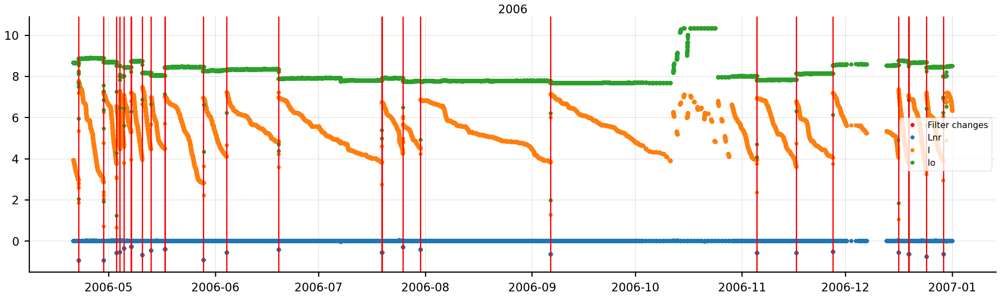

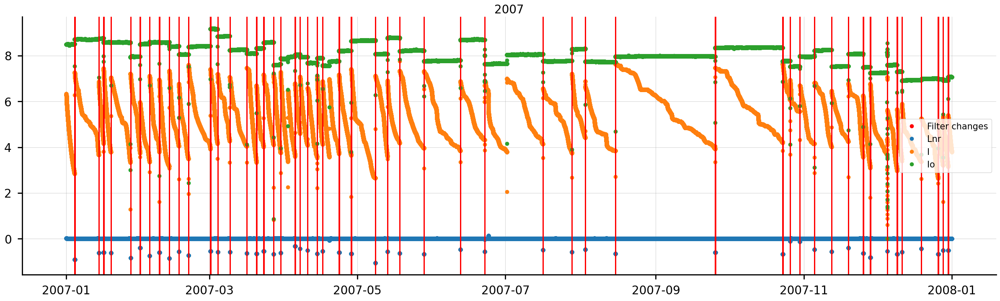

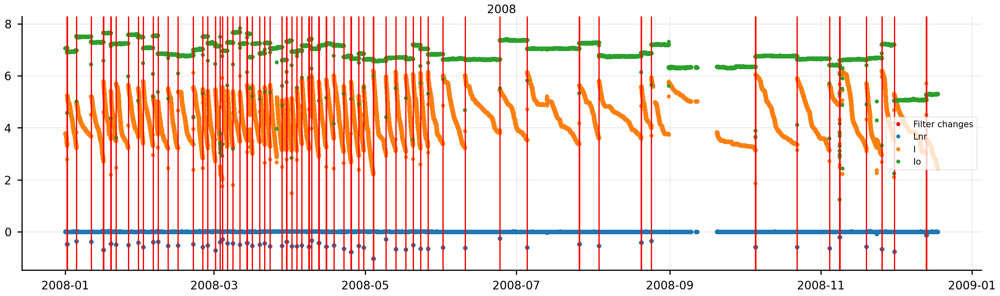

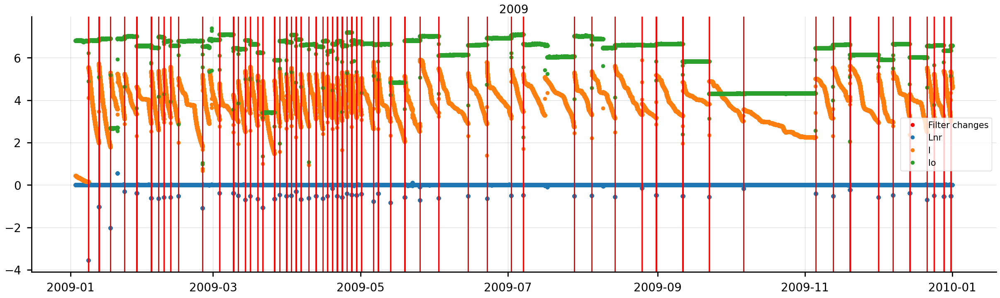

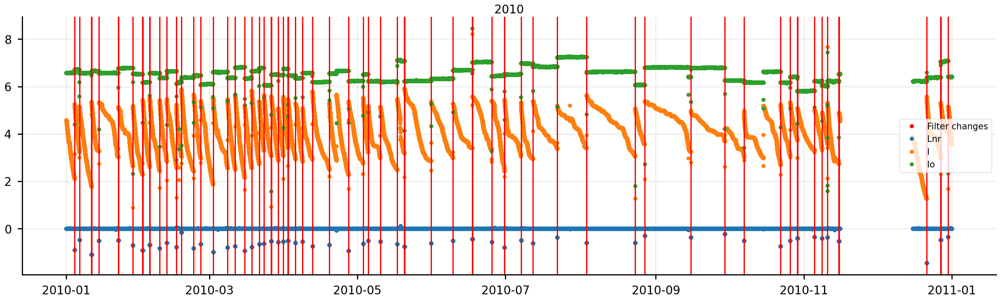

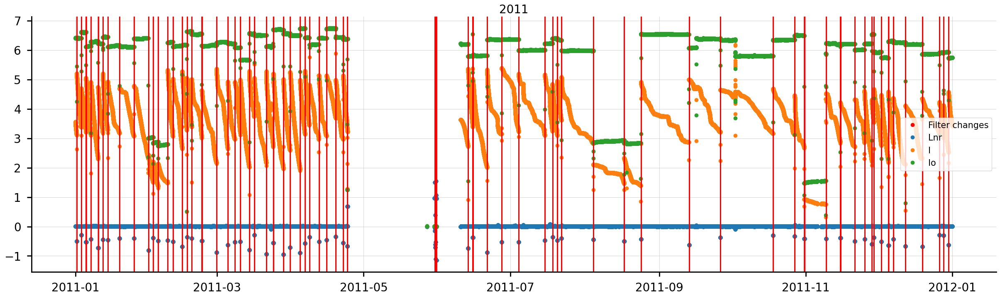

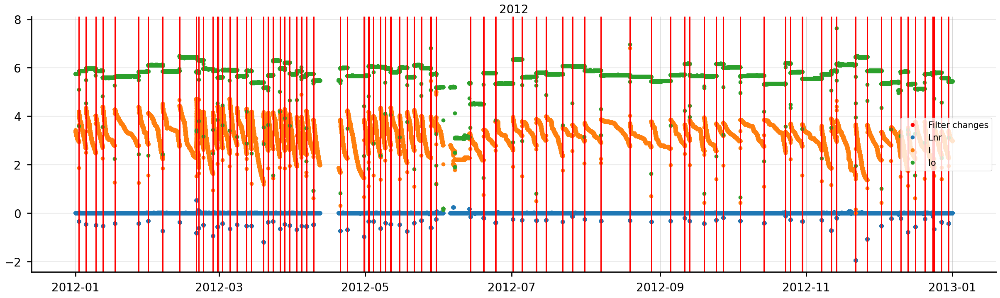

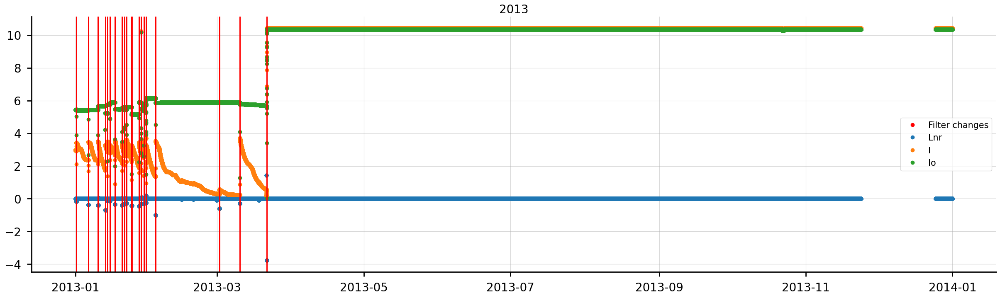

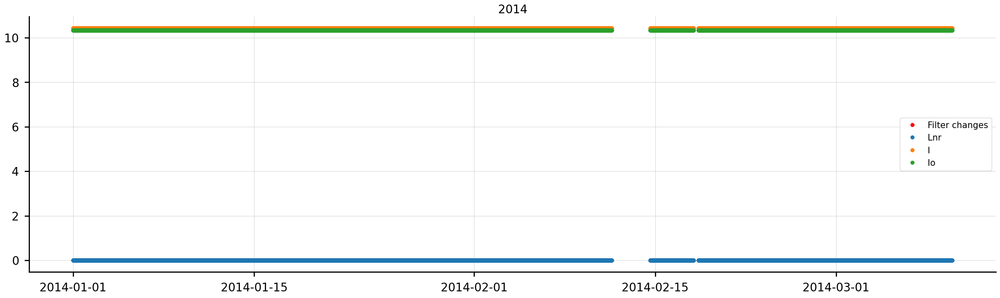

In [8]:
for year in np.arange(2006,2015,1):
    fu_OldPSAP.filter_plot(RAW_OLD_PSAP, dt_min=str(year)+'-01-01 00:00:00', 
                           dt_max=str(year+1)+'-01-01 00:00:00')

In [9]:
RAW_OLD_PSAP = fu_OldPSAP.find_time_difference(RAW_OLD_PSAP)

1.007087768237503 minutes


In [10]:
indexs = fu_OldPSAP.filter_change_indexs(RAW_OLD_PSAP)
print(len(indexs))
filter_lines = indexs 
print(len(filter_lines))

Maximum number of filters: 2243
2243
2243


In [11]:
RAW_OLD_PSAP['Filter'] = np.nan
RAW_OLD_PSAP.loc[RAW_OLD_PSAP.index.isin(filter_lines), 'Filter'] = 1 #if in list of filters - add a column and assign as 1
RAW_OLD_PSAP['Filter_cum'] = (RAW_OLD_PSAP['Filter'] == 1).cumsum() 

In [12]:
dfs = fu_OldPSAP.create_dfs_for_filters(RAW_OLD_PSAP) #divide data into the individual filters
dfs_ends_removed = pd.Series(dfs).apply(fu_OldPSAP.remove_ends) #remove ends 
dfs_minimum_size = fu_OldPSAP.minimum_size_of_dfs(dfs_ends_removed) #_ends_removed

dfs = dfs_minimum_size.copy()

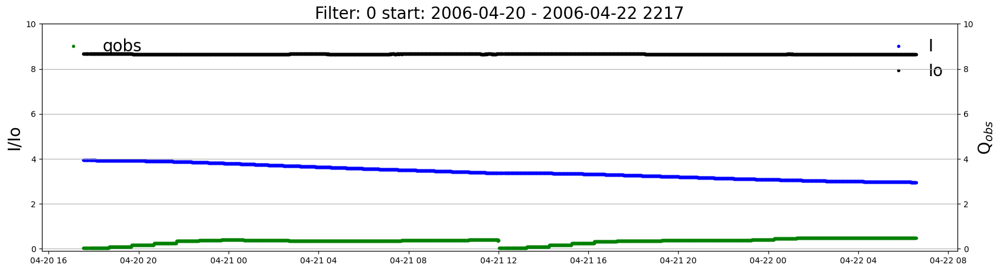

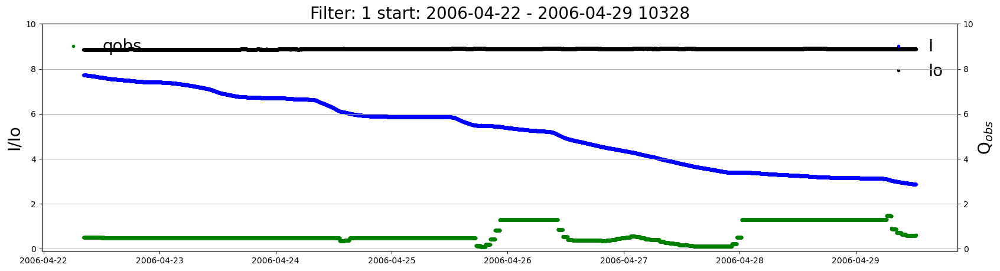

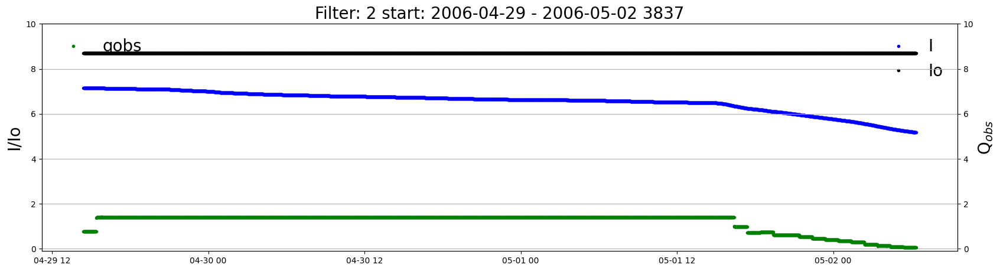

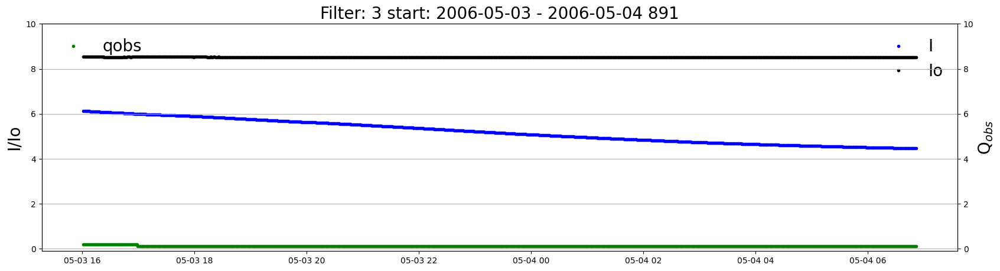

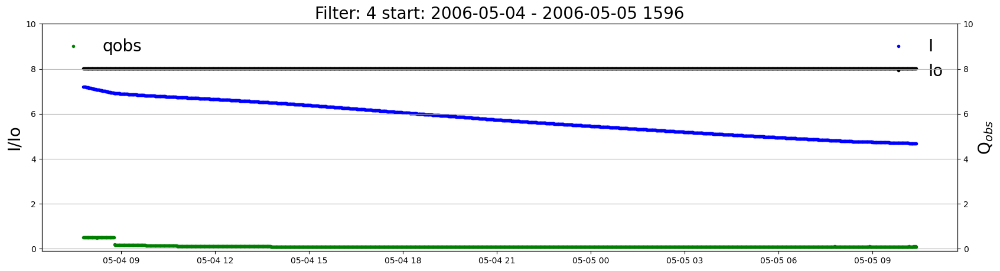

...

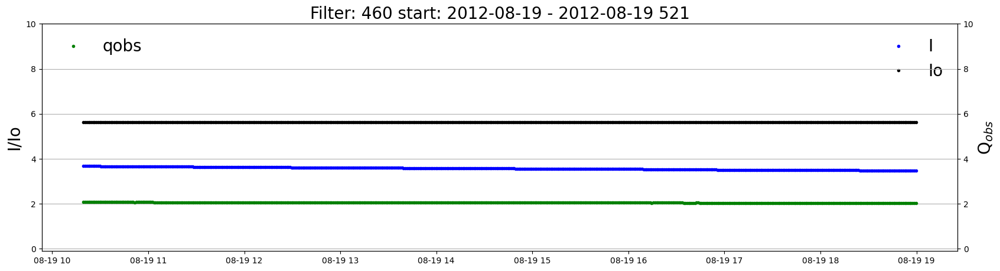

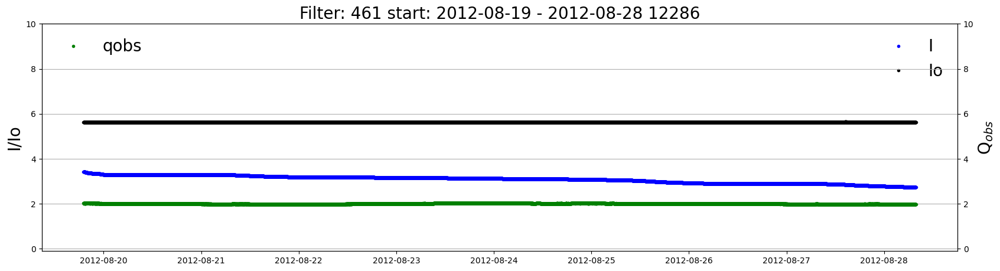

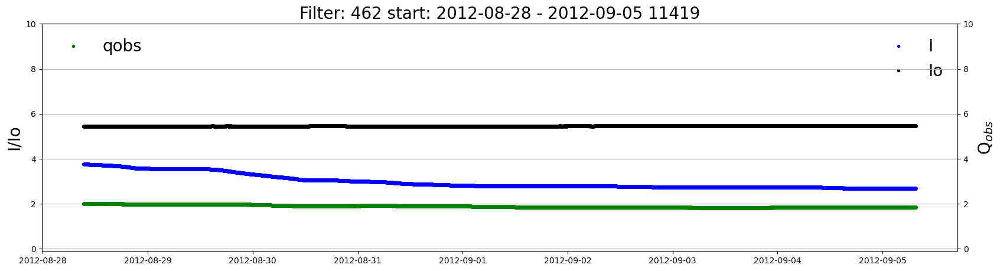

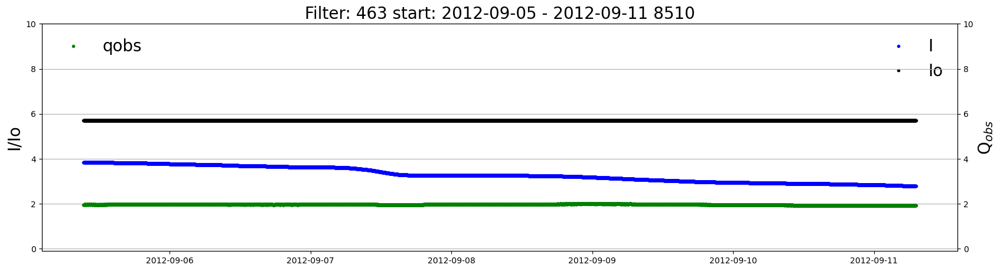

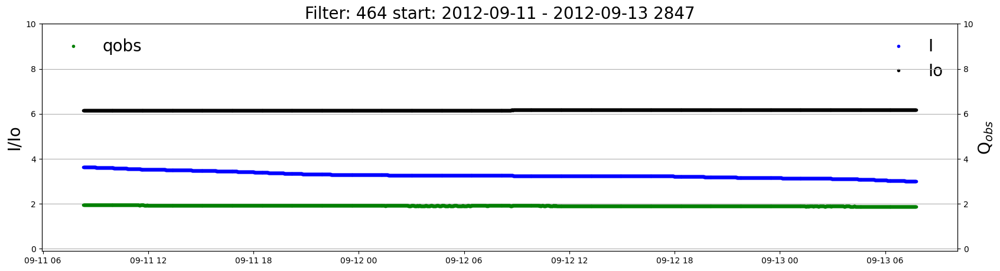

KeyboardInterrupt: 

In [13]:
for i, df in enumerate(dfs_minimum_size): #count, value in enumerate
    fu_OldPSAP.plot_each_filter(df, i)

In [ ]:
fu_OldPSAP.create_info_table(dfs)

In [ ]:
df_concat = pd.concat(dfs) #concat all the dfs
fu_OldPSAP.save_df(df_concat, name='RAW_OLD_PSAP_cleaned', path=savepath)

# Bond (1999): 

### Operation 

The simplest calculation of absorption coefficient, in units of m$^{-1}$, is given by the equation below for any fillter-based method:

\begin{equation}
\sigma_{\mathrm{ap}}^{\prime}=\frac{A}{V} \ln \left[\frac{I_{0}}{I}\right]
\end{equation}

The value actually reported by the PSAP (sPSAP ) includes an empirical calibration that accounts for both of these effects:

\begin{equation}
\sigma_{\mathrm{PSAP}}=\frac{\sigma_{\mathrm{ap}}^{\prime}}{2(0.5398 \tau+0.355)}
\end{equation}

where $\tau$ is the filter transmission ($\tau$ = 1 for an unloaded filter; this value is reset by the user after installation of each new filter).

### Spot correction

\begin{equation}
F_{spot} = \frac{\sigma_{calib}}{\sigma_{PSAP}} = (\frac{D_{meas}}{D_{calib}})^{2}
\end{equation}

### Flow calibaration

$F_{flow} = $ for this instrument there no flow correction factor used

\begin{equation}
\sigma_{a d j}=\sigma_{\mathrm{PSAP}} F_{f} \operatorname{low} F_{s p o t}
\end{equation}

### PSAP Correction 

The adjustment to and uncertaintiesin the PSAP are summarized below:

\begin{equation}
\sigma_{ap} = \frac{\sigma_{adj} - K_{1}\sigma_{sp} + \epsilon_{slope} + \epsilon_{noise}}{K_{2}}
\end{equation}

### Instrument Precision

where K1 = 0.02 ± 0.02, K2 = 1.22 ± 0.20, sadj is the reported value after the flow and spot size corrections, $\sigma_{sp}$ is the scattering coefficient at 550nm, and $\epsilon_{slope}$ + $\epsilon_{noise}$ are defined in Equations (7) and (8) in Bond (1999). $\epsilon_{slope}$ = 0.06$\sigma_{ap, meas}$ and $\epsilon_{noise}$ = 0.18$\sqrt{\tau_{0}/\tau}$, $\tau$ is the averaging time and $\tau_{0}$ = 24 min.

applied after flow and spot size corrections - $\sigma_{sp}$ is the scattering coefficient at 550 nm

The formula for the Bond correction has been simplifed to the follwoing in other studies: 
<br>
$\sigma_{(t)} = A/Vln(I(t-\Delta t)/I(t)) \cdot 1/1.317 \cdot \tau + 0.866 - 0.016 \cdot \sigma_{sp}$

\begin{equation}
\begin{aligned}
\sigma_{\mathrm{ap}}(t)= & \frac{A}{Q \cdot \Delta t} \ln \left(\frac{I(t-\Delta t)}{I(t)}\right) \cdot \frac{1}{1.317 \cdot \tau+0.866}-0.016 \cdot \sigma_{\mathrm{sp}}
\end{aligned}
\end{equation}

In [14]:
area = 8.04*10**(-6)  #surface area of filter
radius = np.sqrt((area*(1000)**2)/np.pi) 
print(str(radius) + ' mm')
print('Diameter: ' + str(radius*2) + ' mm')
spot_correction = 1 #spot correction not used

1.599753570059363 mm
Diameter: 3.199507140118726 mm


In [15]:
df_averaging_times = fu_OldPSAP.bond(dfs_minimum_size, time_step=15, window=3, min_periods=1, center=True)

Bond correction 

Avergaing over the time step: 15 mins
Area: 8.04e-06


In [16]:
df_averaging_times

,filter_num,volume,ln_tr,abs_ln,Tr,R,Qstd
Datetime,,,,,,,
2006-04-20 17:33:01,1.0,0.000581,0.000304,4.202198,0.999983,1.789582,1.233852e-01
2006-04-20 17:34:01,1.0,0.000581,0.000281,3.892935,0.999975,1.789573,1.233852e-01
2006-04-20 17:35:01,1.0,0.000581,0.000232,3.207072,0.999942,1.789537,1.233852e-01
2006-04-20 17:36:01,1.0,0.000581,0.000186,2.573945,0.999893,1.789484,1.233852e-01
2006-04-20 17:37:01,1.0,0.000582,0.000163,2.256525,0.999859,1.789448,1.233852e-01
...,...,...,...,...,...,...,...
2014-03-09 22:40:48,574.0,0.152617,0.000000,0.000000,1.000000,1.789600,1.776357e-15
2014-03-09 22:41:48,574.0,0.152617,0.000000,0.000000,1.000000,1.789600,1.776357e-15
2014-03-09 22:42:48,574.0,0.152617,0.000000,0.000000,1.000000,1.789600,1.776357e-15


In [ ]:
fig = fu_OldPSAP.plot_transmission(df_averaging_times)

In [ ]:
df_averaging_times = fu_OldPSAP.select_for_transmission(df_averaging_times)

In [ ]:
df_averaging_times.volume.mean()
df_averaging_times.abs_ln.mean()

In [ ]:
fig = fu_OldPSAP.plot_transmission(df_averaging_times)

In [ ]:
fig = fu_OldPSAP.inital_plot(df_averaging_times, var='abs_ln', ymax=60)

In [23]:
df_abs_without_scat = df_averaging_times.copy()

Save to: C:\Users\DominicHeslinRees\Documents\Analysis\absorption\Old_PSAP


In [ ]:
fu_OldPSAP.save_df(df_abs_without_scat, name='df_abs_without_scat', path=savepath)

In [24]:
loadpath = "C:\\Users\\DominicHeslinRees\\Documents\\Analysis\\Neph\\"

print("load from :"+str(loadpath))
df_neph_noLOD = pd.read_csv(loadpath+"df_noLOD.dat", index_col=0, parse_dates=True)
df_neph_LOD = pd.read_csv(loadpath+"df_LOD.dat", index_col=0, parse_dates=True)

load from :C:\Users\DominicHeslinRees\Documents\Analysis\Neph\


In [25]:
loadpath = "C:\\Users\\DominicHeslinRees\\Documents\\Analysis\\Mie_DMPS\\"

df_2000_2005_Mie = pd.read_csv(loadpath+"df_2000_2005_Mie.dat", index_col=0, parse_dates=True)
df_2006_2009_Mie = pd.read_csv(loadpath+"df_2006_2009_Mie.dat", index_col=0, parse_dates=True)
df_2010_2020_Mie = pd.read_csv(loadpath+"df_2010_2020_Mie.dat", index_col=0, parse_dates=True)

df_2000_2020_Mie = pd.concat([df_2000_2005_Mie, df_2006_2009_Mie, df_2010_2020_Mie])
df_2000_2020_Mie = df_2000_2020_Mie.replace(0, np.nan)

df_2000_2020_Mie['Mie'] = True
df_neph_noLOD['Mie'] = False

df_2000_2020_Mie = df_2000_2020_Mie.sort_index()
df_neph_noLOD = df_neph_noLOD.sort_index()
df_neph_Mie = pd.concat([df_neph_noLOD[['scat450', 'scat550', 'scat700', 'Mie']], 
                         df_2000_2020_Mie[['scat450', 'scat550', 'scat700', 'Mie']]])

## Add avaerge of 2009 & 2011 to fill gaps: 

In [26]:
df_neph_Mie_2009 = fu_OldPSAP.select_year(df_neph_Mie, year=2009)
df_neph_Mie_2009.index = df_neph_Mie_2009.index + pd.DateOffset(years=1)
print(len(df_neph_Mie_2009))
df_neph_Mie_2011 = fu_OldPSAP.select_year(df_neph_Mie, year=2011)
df_neph_Mie_2011.index = df_neph_Mie_2011.index - pd.DateOffset(years=1) 
print(len(df_neph_Mie_2011))

df_neph_Mie_2009_and_2011 = pd.concat([df_neph_Mie_2009, df_neph_Mie_2011])
df_neph_Mie_2009_and_2011['Mie'] = 'constant' 

df_neph_Mie_2009_and_2011.loc[:, ['scat450','scat550','scat700']] = \
df_neph_Mie_2009_and_2011.loc[:,['scat450','scat550','scat700']].resample('H').mean()
df_neph_Mie = pd.concat([df_neph_Mie, df_neph_Mie_2009_and_2011])

6926
9666


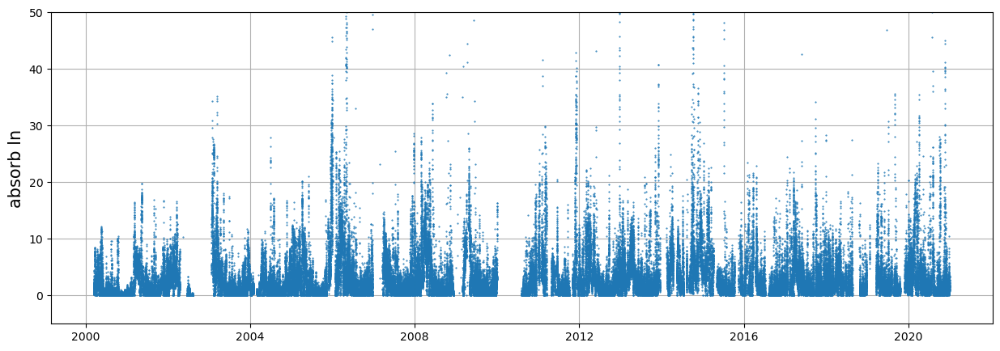

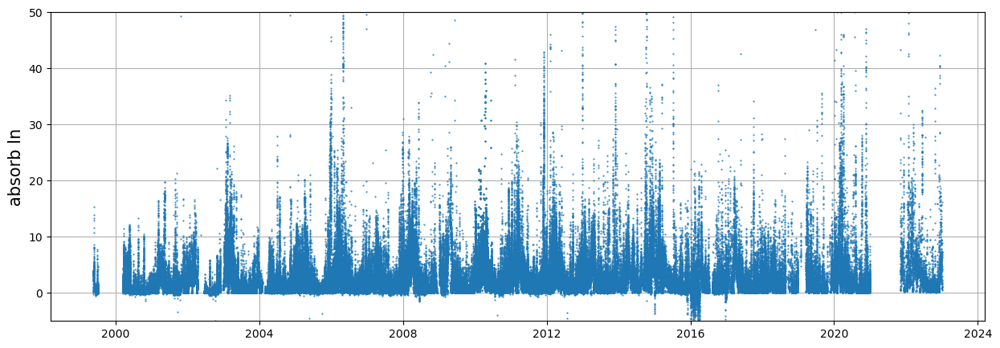

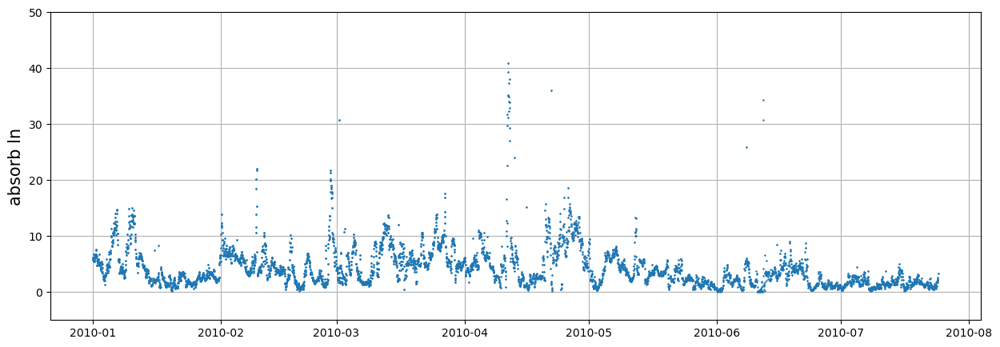

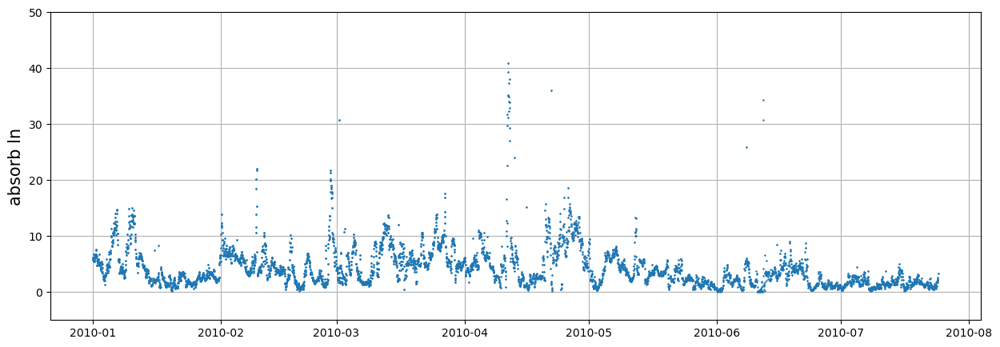

In [27]:
fu_OldPSAP.inital_plot(df_2000_2020_Mie, var='scat550', ymax=50)
fu_OldPSAP.inital_plot(df_neph_Mie, var='scat550', ymax=50)
fu_OldPSAP.inital_plot(df_neph_Mie_2009_and_2011, var='scat550', ymax=50)

In [28]:
df_first, df_last = fu_OldPSAP.remove_duplicates(df_neph_Mie)
df_scat = df_first.copy()
df_scat = df_scat.sort_index()

Length before: 291055
Duplicate Rows except first occurrence based on all columns are :
103473
Length after: 187582
Length after: 187582


In [29]:
df_abs_scat = pd.merge_asof(df_abs_without_scat, df_scat, left_index=True, right_index=True, 
                            tolerance=pd.Timedelta("1H"), direction='nearest')

In [30]:
df_abs_neph = fu_OldPSAP.remove_neph(df_abs_scat) 

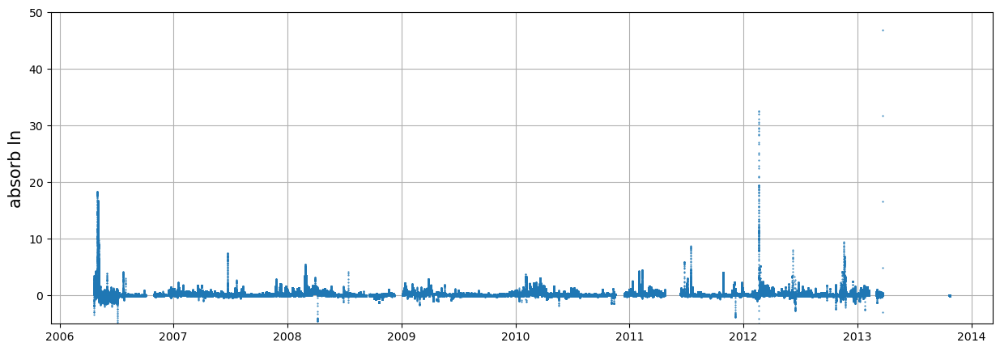

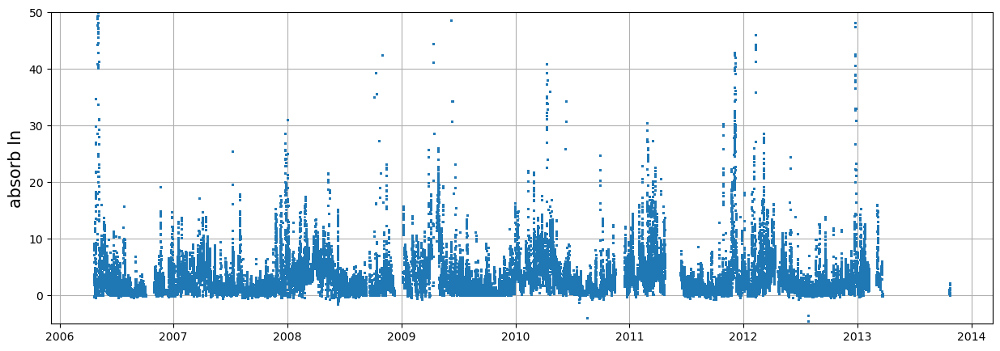

In [31]:
fig = fu_OldPSAP.inital_plot(df_abs_neph, var='abs_neph', ymax=50)
fig = fu_OldPSAP.inital_plot(df_abs_neph, var='scat550', ymax=50)

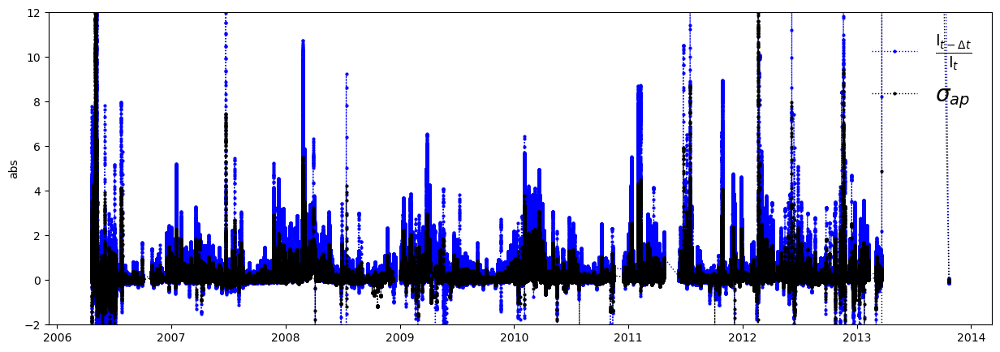

In [32]:
fig, ax = plt.subplots(figsize=(15,5))
ax.plot(df_abs_neph.index, df_abs_neph.abs_ln, 'o', ms=2, ls=':', lw=1, mec='blue', c='blue',
        label = r'$\frac{\mathrm{I}_{t-\Delta t}}{\mathrm{I}_{t}}$')
ax.plot(df_abs_neph.index, df_abs_neph.abs_neph, 'o', ms=2, ls=':', lw=1, mec='black', c='black', 
        label = '$\sigma_{ap}$')
ax.set_ylim(-2,12)
ax.set_ylabel('abs')
ax.legend(fontsize=20, frameon=False, loc=1)
plt.show()

In [33]:
def create_regession_plot_simple(df, x_var, y_var, set_max_value=20, ymax=100, xmax=100,
                                 title='', savename='default', xlabel='',ylabel=''):    
    fig, ax = plt.subplots(figsize=(5,5))   

    df = df[[x_var, y_var]].copy()    
    df = df[(df[x_var] <= xmax) & (df[y_var] <= ymax)].copy()
    df = df[(-10 <= df[x_var]) & (-10 <= df[y_var])].copy()
    
    df = df.replace(0, np.nan)
    df = df[~df.isin([np.nan, np.inf, -np.inf]).any(1)] #remove any infs or np.nan

    regr = linear_model.LinearRegression(fit_intercept=False)
    max_value = min(df[x_var].max(), df[y_var].max(), set_max_value) #find max value
    x = np.linspace(0, set_max_value, 20)

    ax.plot(x, x, linestyle='--')
    ax.scatter(df[x_var], df[y_var], color='none', edgecolors='black', s=2)

    Instrument1 = np.array(df[x_var].values)
    Instrument2 = np.array(df[y_var].values)    
    Instrument1 = Instrument1.reshape(-1, 1)
    Instrument2 = Instrument2.reshape(-1, 1)
    regr.fit(Instrument1, Instrument2)
    y_pred = regr.predict(Instrument1)

    R2 =  "{:.2f}".format(float(regr.score(Instrument1,Instrument2)))
    intercept = "{:.2f}".format(float(regr.intercept_))
    coef = "{:.2f}".format(float(regr.coef_[0]))    
    cf =  "{:.2f}".format(float(1/(regr.coef_[0])))    

    #smap = ax.scatter(Instrument1, Instrument2, edgecolors='none')
    ax.plot(Instrument1, y_pred, color='blue', linewidth=2, label='Fitted Line: \n'+str(y_var)+'  = '+str(coef)+str(x_var)+
            '\nR$^{2}$ = '+str(R2)+'\nCF = '+str(cf))

    ax.set_xlabel(xlabel,fontsize=15)   
    ax.set_ylabel(ylabel,fontsize=15)       
    ax.set_title(title + ' No. data points: '+str(len(df))+',\n '+str(df.index[0].strftime("%d-%m-%Y")) +' to '+str(df.index[-1].strftime("%d-%m-%Y")))
    ax.legend(loc=1, fontsize=15, frameon=False)

    ax.set_ylim(-10, ymax)
    ax.set_xlim(-10, xmax)

    plt.grid(True, alpha=0.5)
    plt.show()

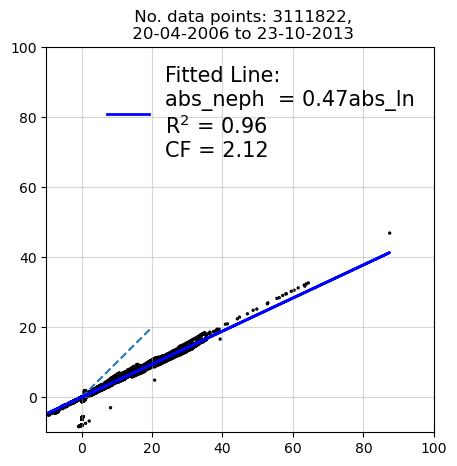

In [34]:
create_regession_plot_simple(df_abs_neph, x_var='abs_ln', y_var='abs_neph', 
                             set_max_value=20, title='', savename='default', xlabel='',ylabel='')

In [35]:
df_abs_neph.head(2)

,filter_num,volume,ln_tr,abs_ln,Tr,R,Qstd,scat450,scat550,scat700,Mie,abs_neph
Datetime,,,,,,,,,,,,
2006-04-20 17:33:01,1.0,0.000581,0.000304,4.202198,0.999983,1.789582,0.123385,3.686995,2.914497,2.092346,True,1.87693
2006-04-20 17:34:01,1.0,0.000581,0.000281,3.892935,0.999975,1.789573,0.123385,3.686995,2.914497,2.092346,True,1.73529


In [36]:
df_abs_neph525 = df_abs_neph.copy()
df_abs_neph525['abs525'] = df_abs_neph['abs_neph']

fu_OldPSAP.save_df(df_abs_neph525, 'Old_PSAP', r'C:\Users\DominicHeslinRees\Documents\Analysis\absorption\Old_PSAP', 
                   float_format=None)

Save to: C:\Users\DominicHeslinRees\Documents\Analysis\absorption\Old_PSAP


### Example:

In [37]:
Qs = RAW_OLD_PSAP['qobs'].values
print(Qs[:20])

[0.0344405 0.0387278 0.0389029 0.0389716 0.0394691 0.0385809 0.0391937
 0.0342856 0.0390396 0.0390779 0.0390834 0.0390696 0.0390912 0.0390977
 0.039083  0.0391046 0.0390632 0.0391148 0.0391194 0.0391016]


In [38]:
time_step = 15
Q = np.convolve(Qs, np.ones(time_step)/time_step, mode='valid')/1000
print(Q[:20])

[3.84076333e-05 3.87185733e-05 3.87409333e-05 3.87550600e-05
 3.87649133e-05 3.87404133e-05 3.87750333e-05 3.88386667e-05
 3.91453400e-05 3.91364667e-05 3.91259333e-05 3.91166867e-05
 3.91101333e-05 3.91126200e-05 3.91043667e-05 3.91699867e-05
 3.91587933e-05 3.91530667e-05 3.91452533e-05 3.91380400e-05]
